In [105]:
import torch
import numpy as np
from PIL import Image
from torchvision.transforms.functional import to_pil_image
from facenet_pytorch.models.mtcnn import PNet, RNet, ONet  # Import P-Net, R-Net, O-Net
from facenet_pytorch import MTCNN
import os
import matplotlib.pyplot as plt
from facenet_pytorch import InceptionResnetV1
import cv2
from sklearn.metrics.pairwise import cosine_similarity
from torch.nn.functional import normalize



In [106]:
studio_images_folder = r'D:\test\studio'  # studio photos
game_images_folder = r'D:\test\game'  # match photos

In [107]:
# Define fine-tuned P-Net, R-Net, and O-Net for finetuning
class FinetunedMTCNN(MTCNN):
    def __init__(self, **kwargs):
        super(FinetunedMTCNN, self).__init__(**kwargs)
        self.pnet = PNet()
        self.rnet = RNet()
        self.onet = ONet()
    def forward(self, x):
        # Overriding forward pass if additional finetuning is needed
        return super().forward(x)

In [108]:
# define different types of facenet models
facenet = InceptionResnetV1(pretrained='vggface2').eval()


In [156]:
# Defining the MTCNN model
finetuned_mtcnn = FinetunedMTCNN(keep_all=True, device='cuda:0' if torch.cuda.is_available() else 'cpu', min_face_size=20)

In [110]:
def find_euclidean_distance(src, dst):
    """Function gets called when aligning the cropped face"""
    return np.linalg.norm(src - dst)

In [146]:
# Function to calculate Cosine Similarity between embeddings
def cosine_similarity_metric(embedding1, embedding2):
    return cosine_similarity(embedding1.reshape(1, -1), embedding2.reshape(1, -1))[0][0]

In [111]:
def alignment_procedure(img, left_eye, right_eye):    
    """Function aligns the cropped face if the angle is not correct. Makes it straight which could help in better face matching task"""
    left_eye_x, left_eye_y = left_eye
    right_eye_x, right_eye_y = right_eye
    
    # Find the direction to rotate the image based on the eye coordinates
    if left_eye_y > right_eye_y:
        point_3rd = (right_eye_x, left_eye_y)
        direction = -1  # Clockwise
    else:
        point_3rd = (left_eye_x, right_eye_y)
        direction = 1  # Counter-clockwise
    
    # Calculate the length of the triangle edges
    a = find_euclidean_distance(np.array(left_eye), np.array(point_3rd))
    b = find_euclidean_distance(np.array(right_eye), np.array(point_3rd))
    c = find_euclidean_distance(np.array(left_eye), np.array(right_eye))
    
    # Apply cosine rule to find the angle
    if b != 0 and c != 0:  # Avoid division by zero
        cos_a = (b**2 + c**2 - a**2) / (2 * b * c)
        angle = np.arccos(cos_a)  # Angle in radians
        angle = np.degrees(angle)  # Convert to degrees
        
        # Adjust the angle based on the rotation direction
        if direction == -1:
            angle = 90 - angle
        
        # Rotate the image using PIL
        #img = Image.fromarray(img)
        img = img.rotate(direction * angle, resample=Image.BICUBIC)
        img = np.array(img)  # Convert back to numpy array
        # aligned_img_pil = Image.fromarray(img)  # Convert back to PIL Image for saving
        # aligned_img_pil.show()
    return img

In [112]:
def process_and_save_studio_faces(image_folder, mtcnn_model, margin=0):
    global studio_photos_all
    studio_photos_all = []
    studio_photos_paths = []
    for filename in os.listdir(image_folder):
        if filename.lower().endswith(".jpg"):
            image_path = os.path.join(image_folder, filename)
            image = Image.open(image_path)
            boxes, confidences, landmarks = mtcnn_model.detect(image, landmarks=True)
            if boxes is not None:
                threshold = 0.96
                filtered_faces = [i for i, confidence in enumerate(confidences) if confidence > threshold]
                for i in filtered_faces:
                    box = boxes[i]  # Get the bounding box for the filtered face
                    box = [int(b) for b in box]  # Ensure the box is in integer format
                    x1 = max(0, box[0] - margin)  # Left
                    y1 = max(0, box[1] - margin)  # Top
                    x2 = min(image.width, box[2] + margin)  # Right
                    y2 = min(image.height, box[3] + margin)  # Bottom
                    cropped_face = image.crop((x1, y1, x2, y2))
                    if cropped_face is not None:
                        left_eye = landmarks[i][0]
                        right_eye = landmarks[i][1]
                        aligned_face = alignment_procedure(cropped_face, left_eye, right_eye)
                        # Print the confidence and the corresponding image path
                        #print(f"Confidence: {confidences[i]:.4f}, Image Path: {image_path}")
                        studio_photos_all.append(aligned_face)
                        studio_photos_paths.append(image_path)  # Store original image path
    return studio_photos_paths


In [113]:
# def process_and_save_studio_faces(image_folder, mtcnn_model, margin=0):
#     global studio_photos_all
#     studio_photos_all = []
#     studio_photos_paths = []
#     for filename in os.listdir(image_folder):
#         if filename.lower().endswith(".jpg"):
#             image_path = os.path.join(image_folder, filename)
#             image = Image.open(image_path)
#             boxes, confidences, landmarks = mtcnn_model.detect(image, landmarks=True)
#             if boxes is not None:
#                 threshold = 0.92
#                 filtered_faces = [i for i, confidence in enumerate(confidences) if confidence > threshold]
#                 for i in filtered_faces:
#                     box = boxes[i]  # Get the bounding box for the filtered face
#                     box = [int(b) for b in box]  # Ensure the box is in integer format
#                     x1 = max(0, box[0] - margin)  # Left
#                     y1 = max(0, box[1] - margin)  # Top
#                     x2 = min(image.width, box[2] + margin)  # Right
#                     y2 = min(image.height, box[3] + margin)  # Bottom
#                     cropped_face = image.crop((x1, y1, x2, y2))
#                     if cropped_face is not None:
#                         left_eye = landmarks[i][0]
#                         right_eye = landmarks[i][1]
#                         aligned_face = alignment_procedure(cropped_face, left_eye, right_eye)
#                         studio_photos_all.append(aligned_face)
#                         studio_photos_paths.append(image_path)  # Store original image path
#     return studio_photos_paths  # Return list of original image paths


In [157]:
def process_and_save_game_faces(image_folder, mtcnn_model, output_folder, margin=0):
    global game_photos_all
    game_photos_all = []
    game_photos_paths = []
    for filename in os.listdir(image_folder):
        if filename.lower().endswith(".jpg"):
            image_path = os.path.join(image_folder, filename)
            image = Image.open(image_path)
            boxes, confidences, landmarks = mtcnn_model.detect(image, landmarks=True)
            if boxes is not None:
                threshold = 0.90
                filtered_faces = [i for i, confidence in enumerate(confidences) if confidence > threshold]
                for i in filtered_faces:
                    box = boxes[i]  # Get the bounding box for the filtered face
                    box = [int(b) for b in box]  # Ensure the box is in integer format
                    x1 = max(0, box[0] - margin)  # Left
                    y1 = max(0, box[1] - margin)  # Top
                    x2 = min(image.width, box[2] + margin)  # Right
                    y2 = min(image.height, box[3] + margin)  # Bottom
                    cropped_face = image.crop((x1, y1, x2, y2))
                    #cropped_face = np.array(cropped_face)
                    if cropped_face is not None:  # Ensure the face is valid
                        left_eye = landmarks[i][0]  # Left eye coordinates for face i
                        right_eye = landmarks[i][1]  # Right eye coordinates for face i
                        aligned_face = alignment_procedure(cropped_face, left_eye, right_eye)
                    game_photos_all.append(aligned_face)
                    game_photos_paths.append(image_path)  # Store original image path
                    img = Image.fromarray(aligned_face)
                    face_output_path = os.path.join(output_folder, f'face_{filename}_{i}.jpeg')
                    img.save(face_output_path)
    return game_photos_paths


In [115]:
# def process_and_save_game_faces(image_folder, mtcnn_model, margin=0):
#     global game_photos_all
#     game_photos_all = []
#     game_photos_paths = []
#     for filename in os.listdir(image_folder):
#         if filename.lower().endswith(".jpg"):
#             image_path = os.path.join(image_folder, filename)
#             image = Image.open(image_path)
#             boxes, confidences, landmarks = mtcnn_model.detect(image, landmarks=True)
#             if boxes is not None:
#                 threshold = 0.96
#                 filtered_faces = [i for i, confidence in enumerate(confidences) if confidence > threshold]
#                 for i in filtered_faces:
#                     box = boxes[i]  # Get the bounding box for the filtered face
#                     box = [int(b) for b in box]  # Ensure the box is in integer format
#                     x1 = max(0, box[0] - margin)  # Left
#                     y1 = max(0, box[1] - margin)  # Top
#                     x2 = min(image.width, box[2] + margin)  # Right
#                     y2 = min(image.height, box[3] + margin)  # Bottom
#                     cropped_face = image.crop((x1, y1, x2, y2))
#                     if cropped_face is not None:  # Ensure the face is valid
#                         left_eye = landmarks[i][0]  # Left eye coordinates for face i
#                         right_eye = landmarks[i][1]  # Right eye coordinates for face i
#                         aligned_face = alignment_procedure(cropped_face, left_eye, right_eye)
#                         # Print the confidence and the corresponding image path
#                         # print(f"Confidence: {confidences[i]:.4f}, Image Path: {image_path}")
#                         game_photos_all.append(aligned_face)
#                         game_photos_paths.append(image_path)  # Store original image path
#     return game_photos_paths  # Return list of original image paths


In [116]:
# # Function to perform face detection and store image paths with their cropped face regions
# def process_and_save_game_faces(image_folder, mtcnn_model, margin=0):
#     global game_photos_all
#     game_photos_all = []
#     game_photos_paths = []
#     for filename in os.listdir(image_folder):
#         if filename.lower().endswith(".jpg"):
#             image_path = os.path.join(image_folder, filename)
#             image = Image.open(image_path)
#             boxes, confidences, landmarks = mtcnn_model.detect(image, landmarks=True)
#             if boxes is not None:
#                 threshold = 0.92
#                 filtered_faces = [i for i, confidence in enumerate(confidences) if confidence > threshold]
#                 for i in filtered_faces:
#                     box = boxes[i]  # Get the bounding box for the filtered face
#                     box = [int(b) for b in box]  # Ensure the box is in integer format
#                     x1 = max(0, box[0] - margin)  # Left
#                     y1 = max(0, box[1] - margin)  # Top
#                     x2 = min(image.width, box[2] + margin)  # Right
#                     y2 = min(image.height, box[3] + margin)  # Bottom
#                     cropped_face = image.crop((x1, y1, x2, y2))
#                     if cropped_face is not None: #and cropped_face.size[0] > 170 and cropped_face.size[1] > 170:
#                         left_eye = landmarks[i][0]  # Left eye coordinates for face i
#                         right_eye = landmarks[i][1]  # Right eye coordinates for face i
#                         aligned_face = alignment_procedure(cropped_face, left_eye, right_eye)
#                         game_photos_all.append(aligned_face)
#                         game_photos_paths.append(image_path)  # Store original image path
#     return game_photos_paths  # Return list of original image paths

In [117]:
# Function to get face embeddings from a pre-cropped face image
def get_face_embedding(image):
    image = cv2.resize(image, (160, 160))  # Resize to 160x160 as required by FaceNet
    # aligned_img_pil = Image.fromarray(image)  # Convert back to PIL Image for saving
    # aligned_img_pil.show()
    image = torch.tensor(image).permute(2, 0, 1).unsqueeze(0).float() / 255.0  # Convert to tensor, normalize
    embedding = facenet(image)  # Get the embedding
    #embedding = normalize(embedding, p=2, dim=1)  # L2 normalization of embeddings
    return embedding.detach().numpy()  # Convert to numpy array

In [118]:
# Function to calculate Euclidean distance between embeddings
def euclidean_distance(embedding1, embedding2):
    return np.linalg.norm(embedding1 - embedding2)

In [40]:
# Process both match and studio images, and return original image paths
studio_photos_paths = process_and_save_studio_faces(studio_images_folder, finetuned_mtcnn, margin=30)
studio_image_shapes = [np.array(image).shape for image in studio_photos_all]
print("Shapes of images in the list studio_photos_all:", studio_image_shapes)
print(f"Number of studio photos: {len(studio_photos_all)}")

Shapes of images in the list studio_photos_all: [(992, 837, 3), (1043, 853, 3), (888, 784, 3), (915, 728, 3), (1043, 844, 3), (976, 858, 3), (893, 789, 3), (1164, 991, 3), (1037, 831, 3), (1131, 907, 3), (1127, 945, 3), (1058, 841, 3), (963, 837, 3), (1003, 837, 3), (994, 777, 3), (1174, 961, 3), (964, 779, 3), (923, 806, 3), (883, 722, 3), (766, 675, 3), (880, 717, 3), (932, 750, 3), (992, 812, 3), (966, 816, 3), (1088, 886, 3), (1168, 910, 3), (1080, 854, 3), (923, 776, 3), (1046, 885, 3), (1001, 804, 3), (1063, 858, 3), (988, 806, 3), (909, 771, 3), (1097, 918, 3), (878, 768, 3), (944, 776, 3), (843, 720, 3), (1163, 944, 3), (1013, 802, 3), (831, 693, 3), (1209, 966, 3), (1090, 897, 3), (1049, 904, 3), (884, 759, 3), (1026, 845, 3), (1019, 892, 3), (1097, 879, 3), (1043, 823, 3), (994, 846, 3), (1120, 859, 3), (915, 728, 3), (975, 761, 3), (997, 810, 3), (1003, 831, 3), (957, 830, 3), (1118, 871, 3), (888, 715, 3), (1004, 860, 3), (1065, 879, 3), (1016, 802, 3), (1001, 776, 3), (940

In [53]:
# Generate embeddings for studio photos
studio_embeddings = []
for i, studio_photo in enumerate(studio_photos_all):
    studio_image = np.array(studio_photo)  # Convert the PIL image to a NumPy array
    embedding = get_face_embedding(studio_image)  # Get embedding
    if embedding is not None:
        studio_embeddings.append((i, embedding))  # Store the index and embedding

In [158]:
# Process and return original match photo paths
output_folder_path = r'D:\test\game_faces'
game_photos_paths = process_and_save_game_faces(game_images_folder, finetuned_mtcnn, output_folder_path, margin=50)
game_image_shapes = [np.array(image).shape for image in game_photos_all]
print("Shapes of images in game photos:", game_image_shapes)
print(f"Number of match photos: {len(game_photos_all)}")

Shapes of images in game photos: [(311, 265, 3), (158, 146, 3), (309, 256, 3), (309, 258, 3), (505, 445, 3), (292, 223, 3), (507, 454, 3), (289, 252, 3), (270, 241, 3), (274, 244, 3), (307, 271, 3), (168, 160, 3), (240, 193, 3), (286, 253, 3), (283, 262, 3), (276, 258, 3), (282, 240, 3), (183, 164, 3), (125, 118, 3), (133, 128, 3), (280, 258, 3), (294, 264, 3), (271, 252, 3), (321, 250, 3), (131, 126, 3), (290, 230, 3), (310, 232, 3), (184, 163, 3), (203, 183, 3), (274, 245, 3), (203, 182, 3), (173, 153, 3), (293, 239, 3), (206, 185, 3), (187, 178, 3), (179, 157, 3), (289, 235, 3), (173, 153, 3), (288, 245, 3), (197, 179, 3), (173, 153, 3), (136, 131, 3), (368, 294, 3), (362, 298, 3), (177, 168, 3), (309, 238, 3), (182, 161, 3), (371, 312, 3), (388, 328, 3), (360, 301, 3), (343, 283, 3), (356, 290, 3), (338, 272, 3), (318, 268, 3), (286, 235, 3), (176, 159, 3), (356, 281, 3), (303, 246, 3), (308, 254, 3), (292, 237, 3), (184, 163, 3), (123, 119, 3), (138, 132, 3), (173, 161, 3), (317, 

In [159]:
# Generate embeddings for match (game) photos
game_embeddings = []
for i, match_photo in enumerate(game_photos_all):
    match_image = np.array(match_photo)  # Convert the PIL image to a NumPy array
    embedding = get_face_embedding(match_image)  # Get embedding
    if embedding is not None:
        game_embeddings.append((i, embedding))  # Store the index and embedding


In [151]:
# Compare studio embeddings with match embeddings
results = {}
threshold = 0.6  # Define a similarity threshold for matches

In [152]:
for studio_idx, studio_embedding in studio_embeddings:
    matched_photos = []
    for game_idx, game_embedding in game_embeddings:
        distance = cosine_similarity_metric(studio_embedding, game_embedding)
        if distance < threshold:  # If distance is below the threshold, consider it a match
            matched_photos.append((game_idx, distance))
    results[studio_idx] = matched_photos  # Store the matching game photos and distances
#print(len(results))
total_matches = sum(len(matches) for matches in results.values())
print(total_matches)

127683


Matching game photos for studio photo index 0:
[(759, 0.8314873), (760, 0.6291433), (768, 0.76330954)]
3


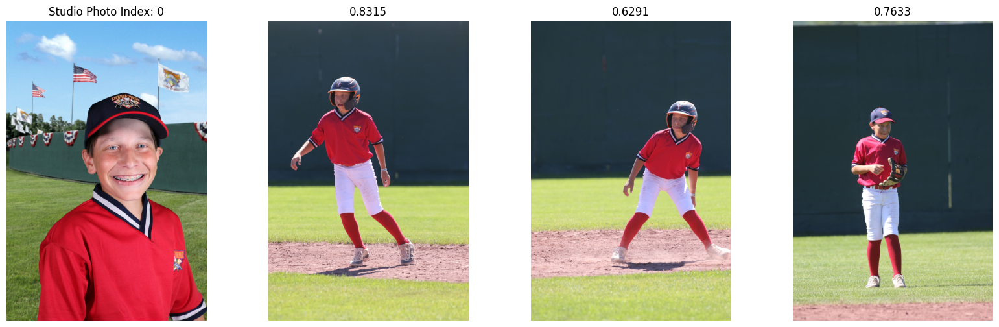

Matching game photos for studio photo index 1:
[(111, 0.8600307), (112, 0.8171355), (397, 0.8180914), (398, 0.8552249), (496, 0.8496805), (497, 0.7978082), (619, 0.86977345), (718, 0.8681352), (871, 0.8517571)]
9


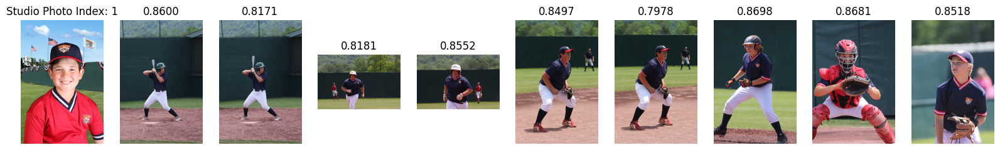

Matching game photos for studio photo index 2:
[]
0
No matches found.
Matching game photos for studio photo index 3:
[(367, 0.80022526), (590, 0.8643227), (596, 0.66032803), (599, 0.8559941), (767, 0.80888695)]
5


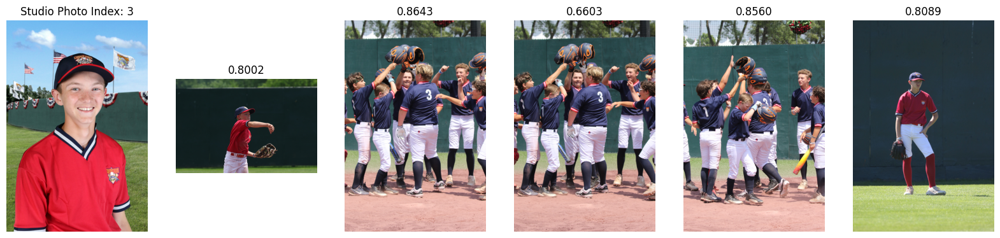

Matching game photos for studio photo index 4:
[(372, 0.8687701), (403, 0.82597506), (412, 0.76556706), (420, 0.74809366), (433, 0.81553465), (586, 0.71605074), (736, 0.8472439), (769, 0.7546302), (783, 0.8656817), (853, 0.7383501), (854, 0.8330176), (856, 0.8050338), (857, 0.81181884), (922, 0.65316164), (1026, 0.8477076), (1066, 0.8326133)]
16


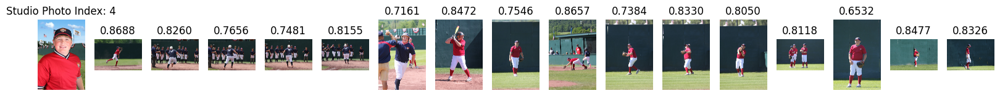

Matching game photos for studio photo index 5:
[(868, 0.8437509), (876, 0.7258275)]
2


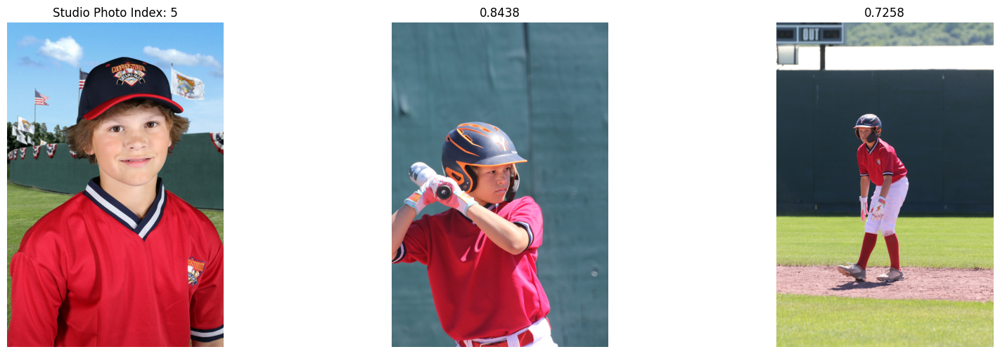

Matching game photos for studio photo index 6:
[(8, 0.7672731), (10, 0.855408), (16, 0.8174134), (17, 0.85737646), (547, 0.81231874), (549, 0.8199923), (598, 0.853768), (602, 0.7571489), (603, 0.839917), (610, 0.7654292), (616, 0.84584546), (642, 0.8521416), (647, 0.86423016), (749, 0.8221084), (750, 0.8289458), (751, 0.85999894), (753, 0.79396653), (755, 0.80891824), (834, 0.8696851), (856, 0.85604817), (868, 0.8605178), (871, 0.835488), (900, 0.8149352), (928, 0.8515552), (1009, 0.85439265), (1020, 0.8495481)]
26


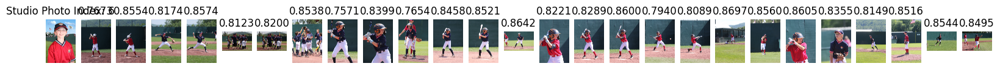

Matching game photos for studio photo index 7:
[(827, 0.85509944), (835, 0.78343), (1069, 0.7699407)]
3


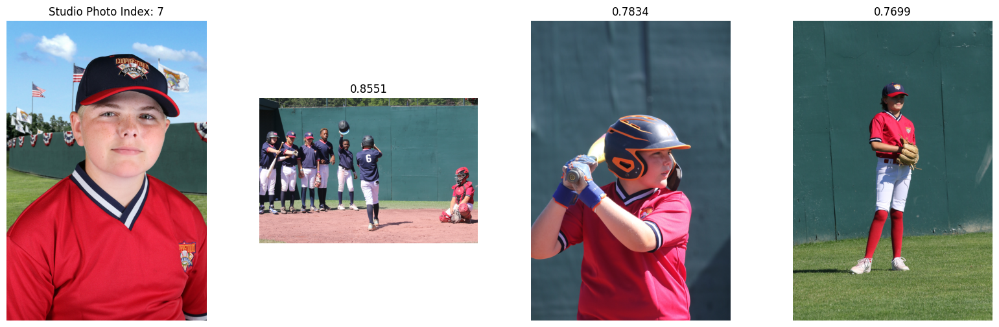

Matching game photos for studio photo index 8:
[(591, 0.7478254), (595, 0.73201424), (615, 0.7713068), (619, 0.7648939), (643, 0.8628506), (978, 0.8681132)]
6


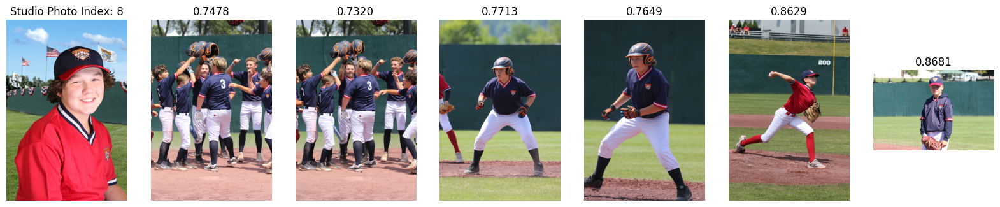

Matching game photos for studio photo index 9:
[(568, 0.69649255), (628, 0.6623865), (684, 0.86840016), (807, 0.829539), (919, 0.8038152), (1149, 0.84937084), (1156, 0.84933203)]
7


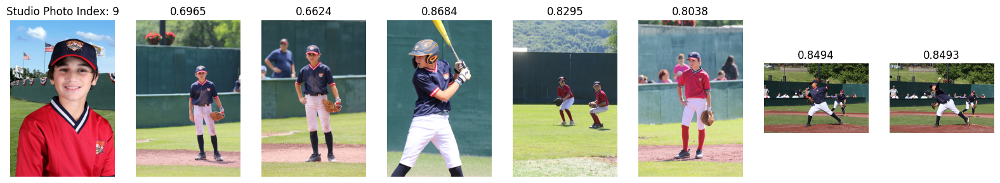

Matching game photos for studio photo index 10:
[]
0
No matches found.
Matching game photos for studio photo index 11:
[(16, 0.8170282), (20, 0.83082795)]
2


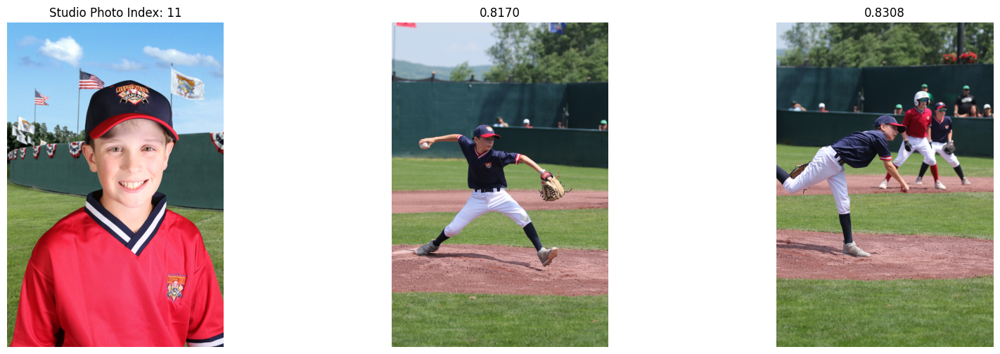

Matching game photos for studio photo index 12:
[]
0
No matches found.
Matching game photos for studio photo index 13:
[(231, 0.814748), (631, 0.8536676)]
2


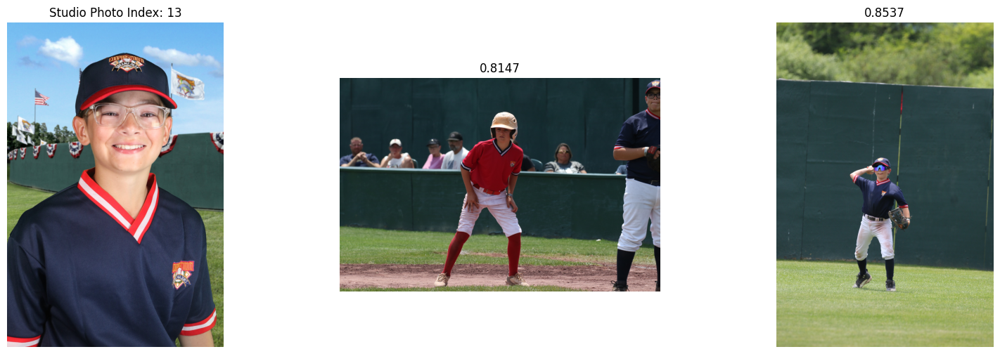

Matching game photos for studio photo index 14:
[(773, 0.74285996), (793, 0.8319595), (875, 0.7384531), (883, 0.7197119), (884, 0.6779975), (919, 0.86825466)]
6


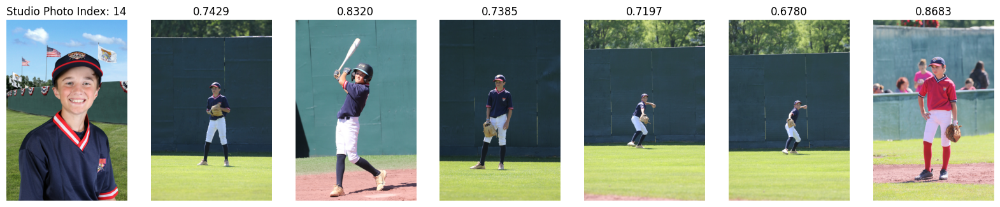

Matching game photos for studio photo index 15:
[(329, 0.8096375), (682, 0.84550667), (765, 0.8100659), (805, 0.7059357), (826, 0.8114766), (873, 0.83068776)]
6


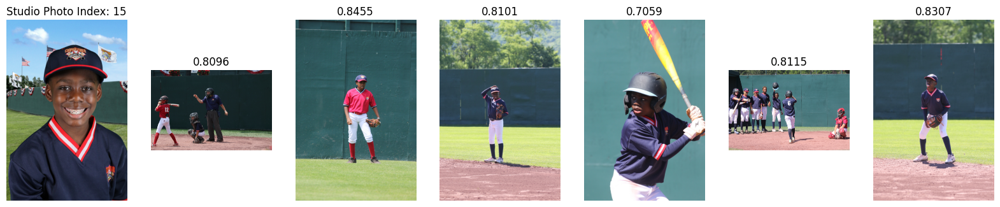

Matching game photos for studio photo index 16:
[(828, 0.8371054)]
1


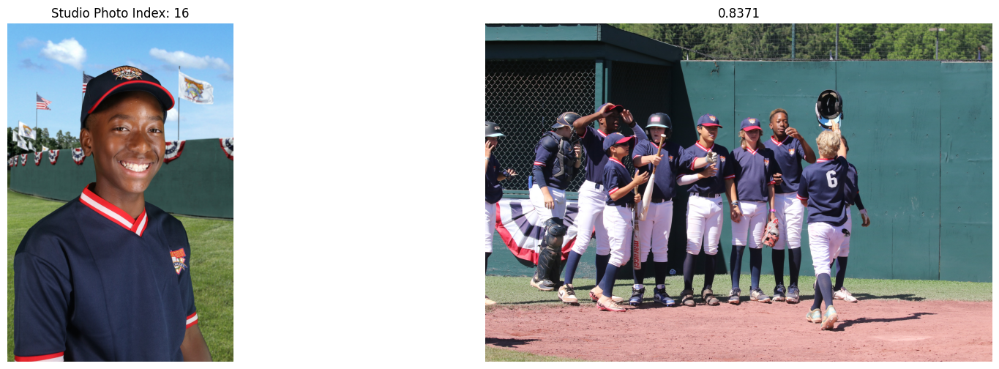

Matching game photos for studio photo index 17:
[(103, 0.8450639), (365, 0.84939265), (367, 0.8129605), (379, 0.85152566), (587, 0.8638454), (821, 0.86956316), (853, 0.8029215)]
7


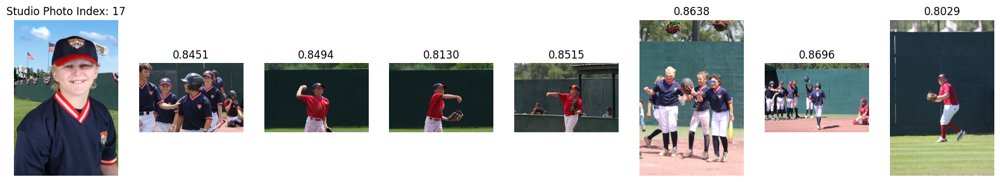

Matching game photos for studio photo index 18:
[(150, 0.82510114)]
1


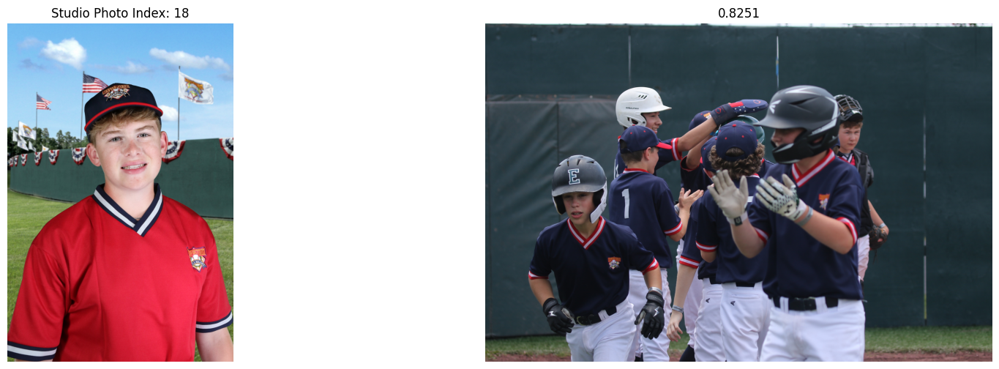

Matching game photos for studio photo index 19:
[(377, 0.73811543), (379, 0.86635035), (381, 0.8289343), (876, 0.76593727), (920, 0.83523786), (992, 0.8693488), (1076, 0.86599976)]
7


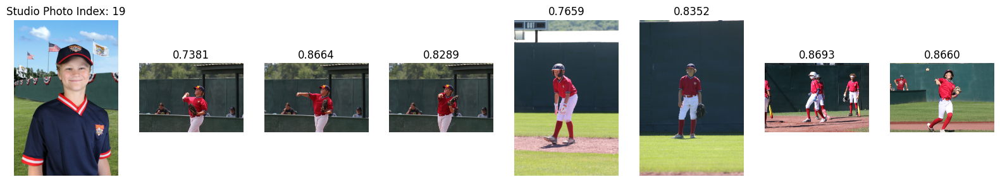

Matching game photos for studio photo index 20:
[(762, 0.6725442), (790, 0.5352258), (874, 0.623309), (923, 0.7204043), (930, 0.8630455)]
5


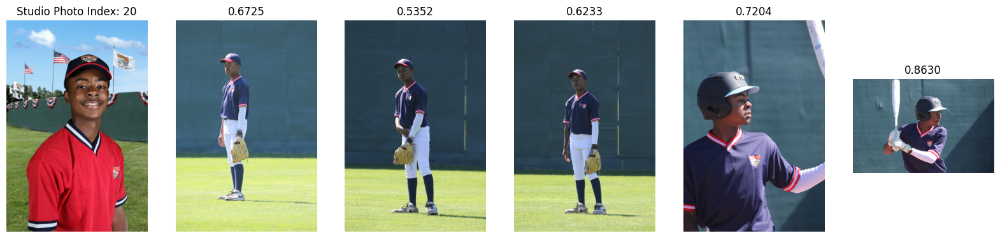

Matching game photos for studio photo index 21:
[(386, 0.79866356), (740, 0.8581101), (930, 0.826697)]
3


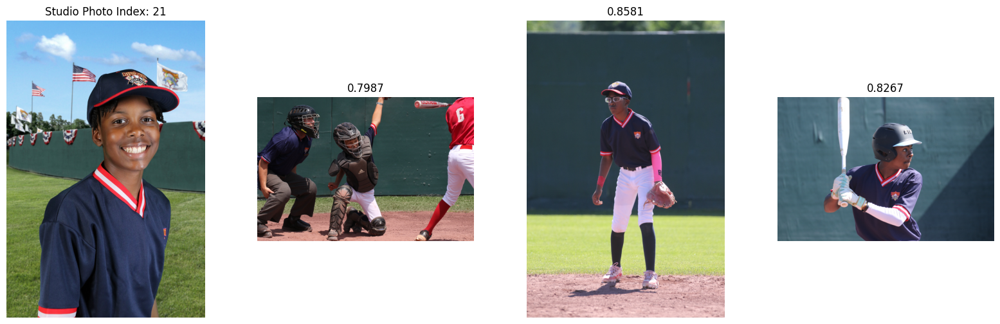

Matching game photos for studio photo index 22:
[(745, 0.6864916), (761, 0.7782836), (763, 0.84748656), (764, 0.7688406), (897, 0.7662566), (898, 0.85868883), (899, 0.8481921), (900, 0.67999756), (901, 0.8364408), (902, 0.8345623), (917, 0.8366024), (947, 0.7701434), (1001, 0.8694582), (1021, 0.86085707), (1110, 0.8180267)]
15


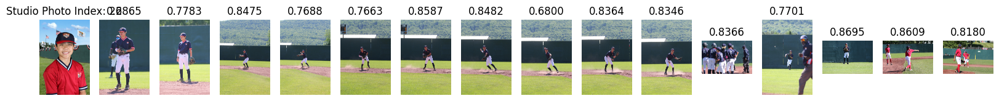

Matching game photos for studio photo index 23:
[(738, 0.72877306), (846, 0.7986032), (865, 0.8465916)]
3


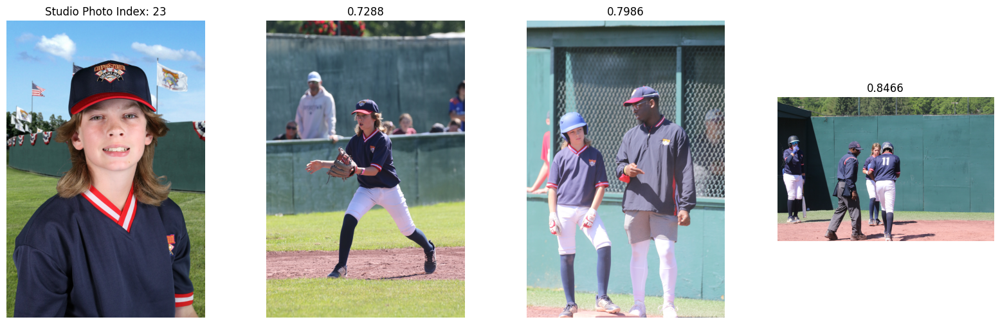

Matching game photos for studio photo index 24:
[(554, 0.8552494), (555, 0.8542757), (557, 0.80110127), (988, 0.7800415), (989, 0.7440218), (1051, 0.77904123), (1052, 0.67288184), (1053, 0.7899879), (1055, 0.8045596), (1110, 0.83778775), (1112, 0.7542917), (1114, 0.75194407), (1117, 0.72175986), (1145, 0.6890739), (1165, 0.8399702)]
15


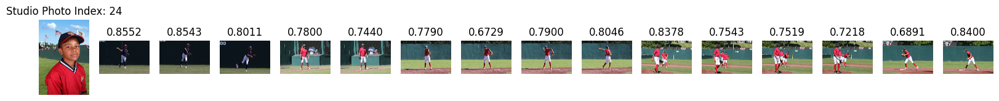

Matching game photos for studio photo index 25:
[(8, 0.806433), (328, 0.85480803), (341, 0.8295667), (349, 0.8672238), (482, 0.8675894), (494, 0.8564998), (574, 0.83449906)]
7


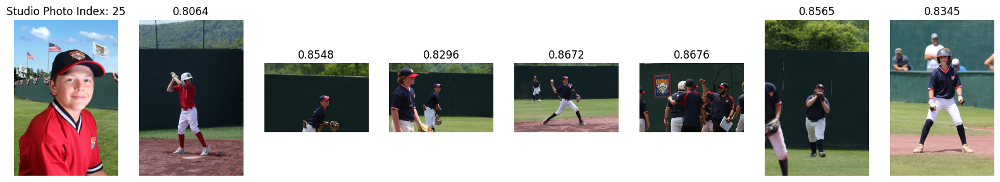

Matching game photos for studio photo index 26:
[(988, 0.8660941), (1022, 0.6804308), (1023, 0.8019051), (1024, 0.8681508), (1070, 0.7189501), (1071, 0.6240905), (1072, 0.58954203), (1073, 0.7297611), (1074, 0.655691), (1075, 0.7463857), (1132, 0.8316745), (1133, 0.83973765)]
12


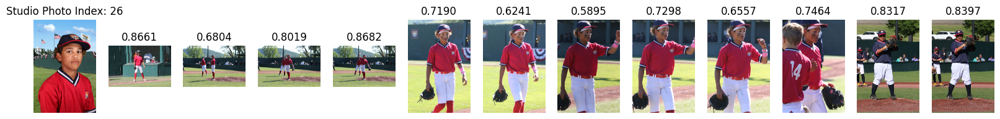

Matching game photos for studio photo index 27:
[(54, 0.8479981)]
1


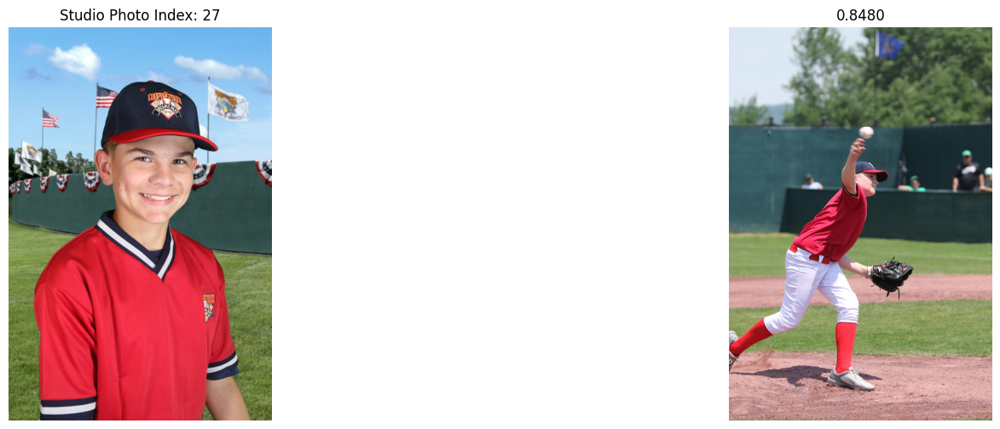

Matching game photos for studio photo index 28:
[(10, 0.86110866), (54, 0.8651741), (312, 0.86403346), (349, 0.84436923), (357, 0.8646409), (445, 0.8488629)]
6


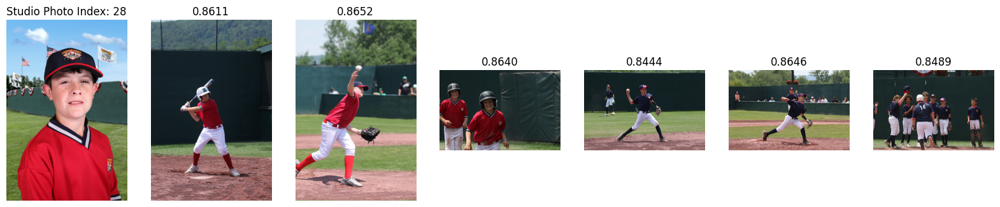

Matching game photos for studio photo index 29:
[(10, 0.7887413), (11, 0.69920164), (12, 0.8233241), (17, 0.8188339), (49, 0.8087822), (50, 0.8630981), (53, 0.8452625), (319, 0.8449616), (365, 0.74763757), (366, 0.7897489), (367, 0.63301754), (395, 0.8180455), (530, 0.85648775), (753, 0.84870815), (853, 0.7549776), (992, 0.8394929), (999, 0.8454436), (1040, 0.8313666), (1137, 0.86262816)]
19


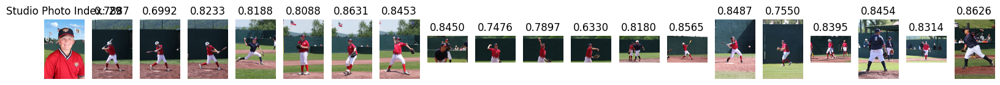

Matching game photos for studio photo index 30:
[(10, 0.76290184), (173, 0.8570736), (199, 0.8504081), (265, 0.86632544), (284, 0.8100037), (287, 0.7518704), (290, 0.7901945), (294, 0.77589285), (304, 0.8509537), (306, 0.8533529), (340, 0.834631), (341, 0.859313), (357, 0.80360454), (395, 0.84889054), (441, 0.86826324), (445, 0.793145), (755, 0.7575379), (997, 0.8475318)]
18


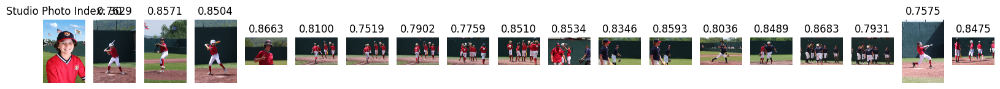

Matching game photos for studio photo index 31:
[(956, 0.70334876), (957, 0.76862854), (960, 0.68515664), (963, 0.85157853), (1051, 0.8544475)]
5


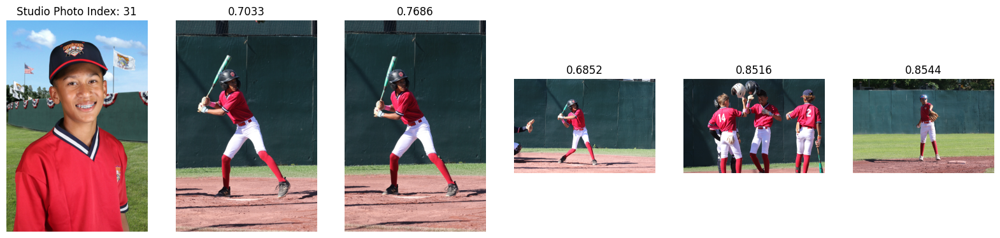

Matching game photos for studio photo index 32:
[(8, 0.853761), (11, 0.8540543), (12, 0.7907129), (16, 0.84537095), (264, 0.8629497), (341, 0.8560502), (772, 0.85274), (852, 0.8452554), (868, 0.8212865), (876, 0.86863047), (886, 0.858992)]
11


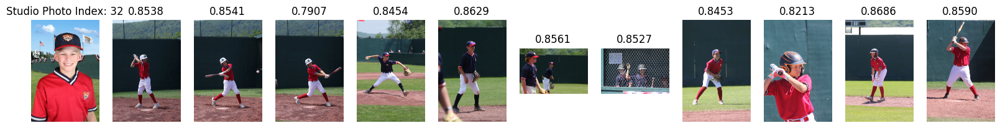

Matching game photos for studio photo index 33:
[(0, 0.8606379), (108, 0.8150149), (111, 0.864047), (112, 0.8438916), (141, 0.80837375), (147, 0.77584445), (151, 0.81368154), (152, 0.8399123), (170, 0.8175426), (173, 0.84770036), (185, 0.8155466), (188, 0.86809963), (305, 0.86417145), (306, 0.81267816), (317, 0.7661592), (367, 0.85690355), (647, 0.84065217), (947, 0.8699016), (1055, 0.79752606), (1166, 0.8477745), (1172, 0.83708066), (1178, 0.8620448), (1184, 0.86899024)]
23


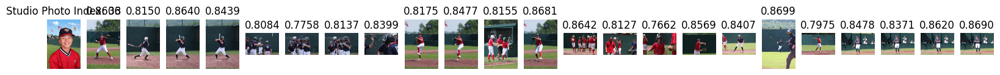

Matching game photos for studio photo index 34:
[]
0
No matches found.
Matching game photos for studio photo index 35:
[(608, 0.84081346), (1067, 0.8002047)]
2


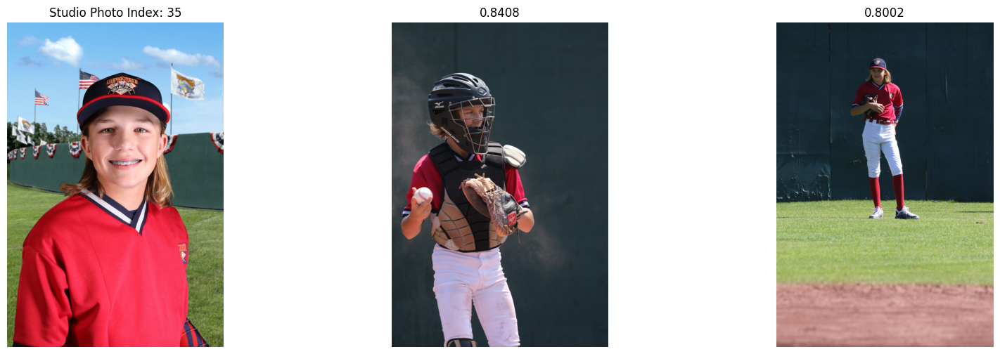

Matching game photos for studio photo index 36:
[(54, 0.8166851), (232, 0.8533232), (235, 0.84213203), (377, 0.71796626), (379, 0.8696458), (381, 0.77870893), (423, 0.85177064), (489, 0.8068754), (510, 0.83924896), (643, 0.8639416), (857, 0.84066844), (978, 0.7667466), (992, 0.86550444), (995, 0.8644038), (1034, 0.8618412), (1065, 0.81456417)]
16


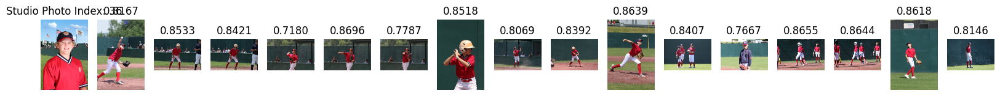

Matching game photos for studio photo index 37:
[(15, 0.8630365), (16, 0.85346156), (64, 0.8524238), (111, 0.84320897), (112, 0.7912459), (578, 0.8373808), (736, 0.83838344)]
7


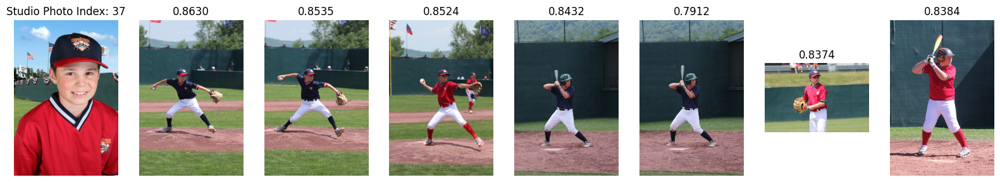

Matching game photos for studio photo index 38:
[(16, 0.8385103), (18, 0.8153371), (20, 0.8409169), (36, 0.8518026), (269, 0.8659342), (349, 0.82069075), (366, 0.7324497), (367, 0.7854105), (422, 0.8243158), (426, 0.82303894), (759, 0.8196669), (1020, 0.8475477)]
12


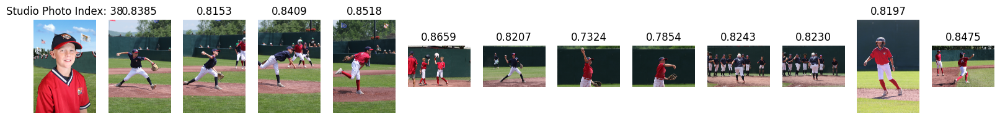

Matching game photos for studio photo index 39:
[(100, 0.79581666), (103, 0.7872659), (319, 0.8177967), (357, 0.81751806), (381, 0.8289332), (569, 0.8667568), (691, 0.86542344), (852, 0.8431604)]
8


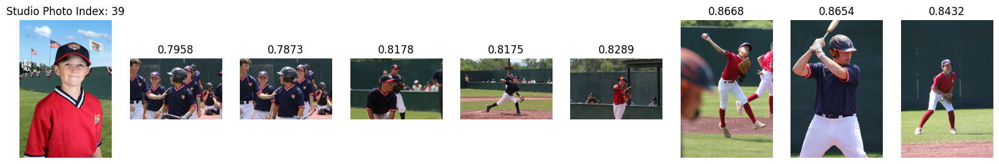

Matching game photos for studio photo index 40:
[(170, 0.8478733), (173, 0.85482913), (185, 0.8617988), (283, 0.8543301), (284, 0.7159124), (287, 0.7253561), (290, 0.7167449), (294, 0.8008304), (302, 0.81818444), (304, 0.8419791), (306, 0.7854759), (323, 0.86089045), (357, 0.77847743), (367, 0.84713805), (465, 0.8622343)]
15


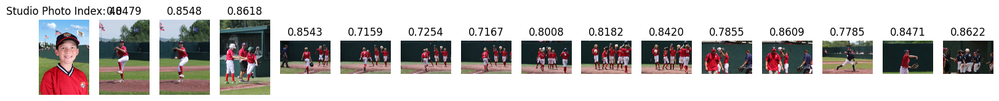

Matching game photos for studio photo index 41:
[(59, 0.8194699), (60, 0.86907166), (72, 0.85961), (122, 0.8419114), (123, 0.8060549), (602, 0.86302847), (856, 0.8494178)]
7


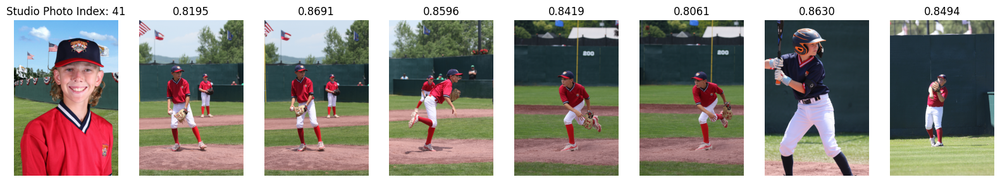

Matching game photos for studio photo index 42:
[(486, 0.822823)]
1


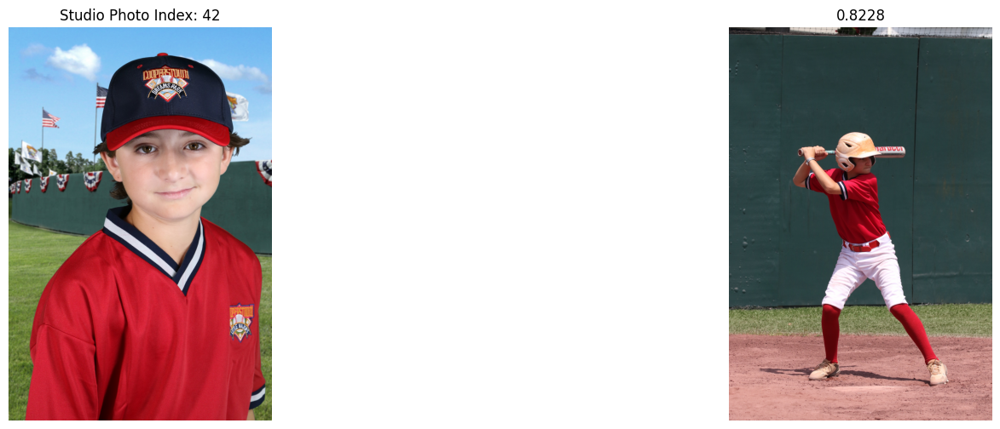

Matching game photos for studio photo index 43:
[(403, 0.8692554), (834, 0.866562)]
2


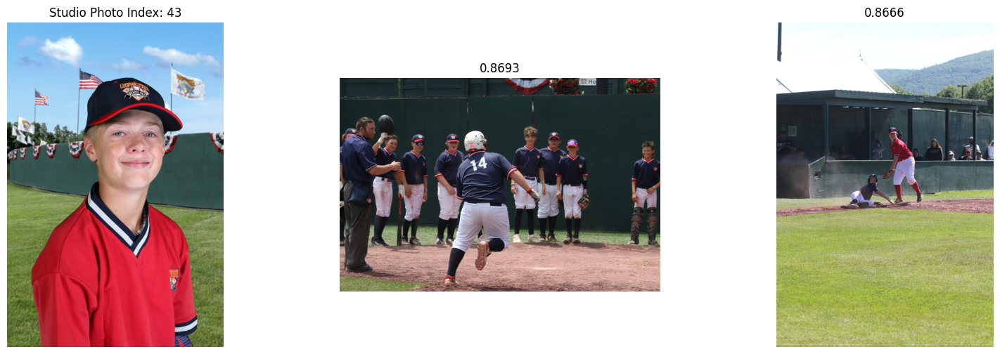

Matching game photos for studio photo index 44:
[(178, 0.8121383), (357, 0.8617986), (358, 0.8634671), (362, 0.84122115), (404, 0.8637526), (414, 0.8523956), (421, 0.8457088), (427, 0.79493004), (437, 0.83246607), (465, 0.85832363), (834, 0.8581848), (962, 0.8309067), (1054, 0.8358761)]
13


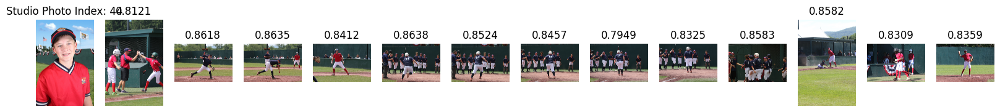

Matching game photos for studio photo index 45:
[(41, 0.82094437), (42, 0.8203776), (43, 0.80020946), (232, 0.79890555), (235, 0.7598121), (307, 0.83525455), (308, 0.7811391), (357, 0.82679296), (423, 0.8563861), (486, 0.8428551), (509, 0.8393527), (510, 0.66411), (511, 0.7797179), (577, 0.843839), (797, 0.85596037), (995, 0.8662943), (1065, 0.8072003), (1149, 0.8406795)]
18


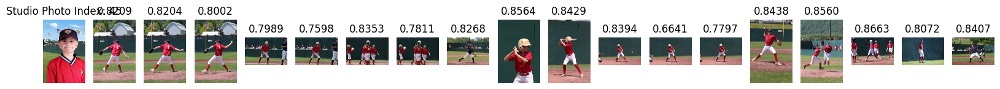

Matching game photos for studio photo index 46:
[]
0
No matches found.
Matching game photos for studio photo index 47:
[]
0
No matches found.
Matching game photos for studio photo index 48:
[(272, 0.85272896), (275, 0.8540322), (277, 0.8622894), (314, 0.85462636), (365, 0.56950206), (366, 0.6352382), (367, 0.5489954), (437, 0.8617366), (853, 0.82971), (1054, 0.7795411)]
10


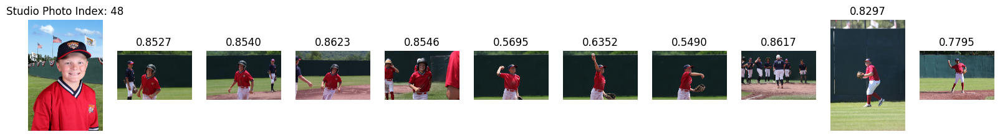

Matching game photos for studio photo index 49:
[(99, 0.84617877), (154, 0.8320044), (161, 0.8694483), (284, 0.86371213), (287, 0.8622613), (325, 0.8418601), (349, 0.85742605), (357, 0.7804665), (367, 0.8382517), (441, 0.8466818), (1069, 0.8501871)]
11


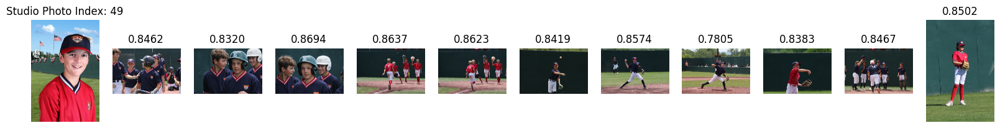

Matching game photos for studio photo index 50:
[(510, 0.84962314), (919, 0.85382724)]
2


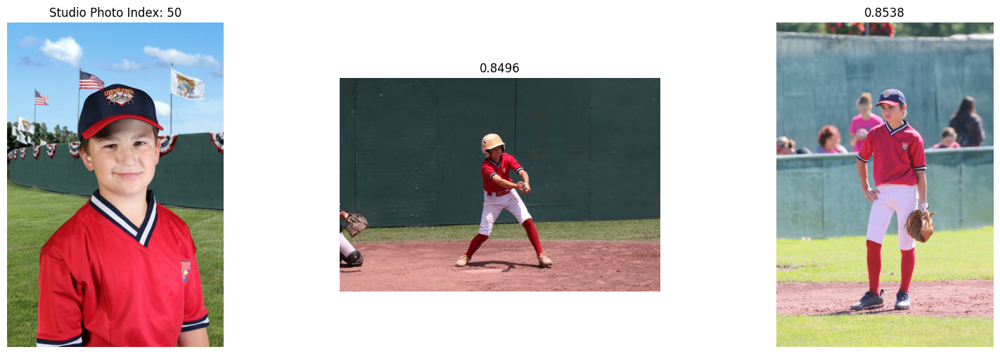

Matching game photos for studio photo index 51:
[(149, 0.82922286)]
1


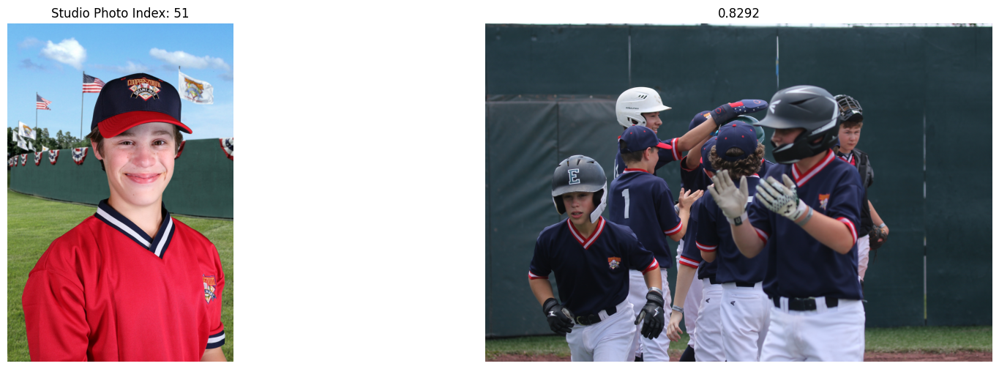

Matching game photos for studio photo index 52:
[(8, 0.86308753), (12, 0.8224724), (16, 0.8174221), (17, 0.752857), (18, 0.83710384), (97, 0.8414724), (100, 0.7115694), (103, 0.71041), (198, 0.86413133), (366, 0.8227126), (367, 0.80143905), (753, 0.8287513), (755, 0.7871037), (1019, 0.7972406), (1020, 0.81991327)]
15


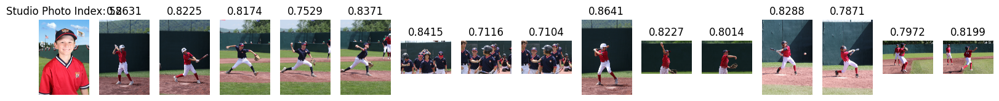

Matching game photos for studio photo index 53:
[(101, 0.8497634), (104, 0.64198375), (266, 0.850698)]
3


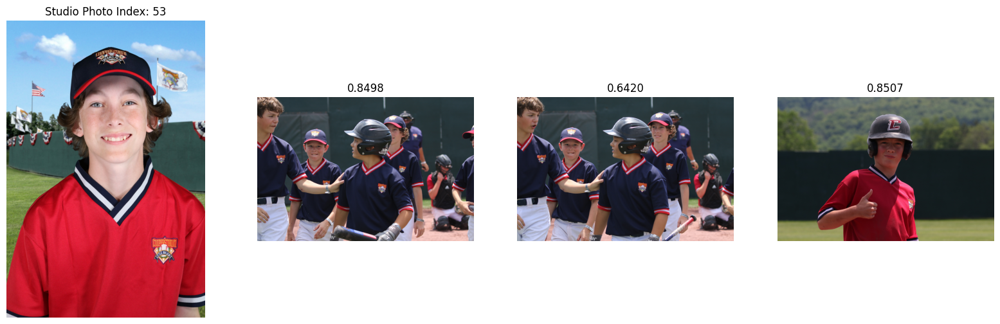

Matching game photos for studio photo index 54:
[(441, 0.8034303), (445, 0.7525851)]
2


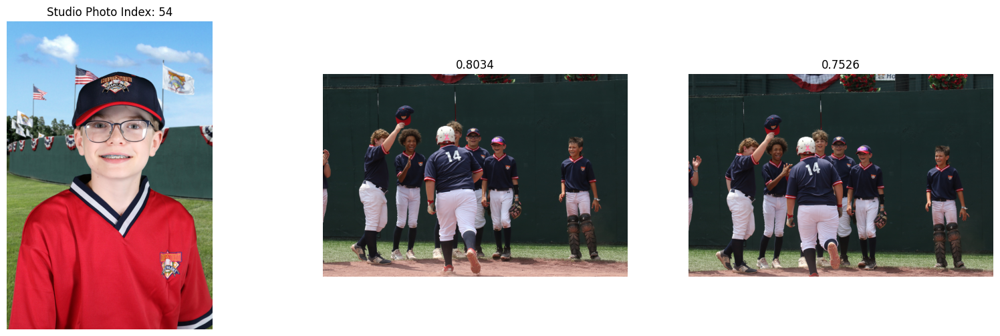

Matching game photos for studio photo index 55:
[(1178, 0.8595497)]
1


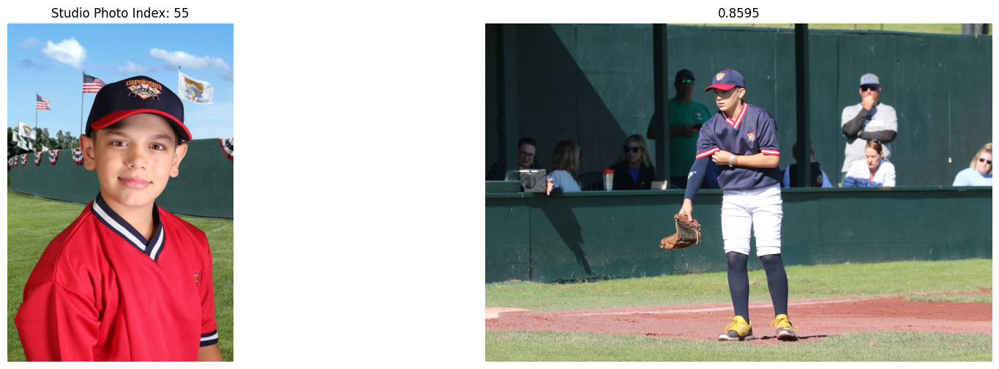

Matching game photos for studio photo index 56:
[(173, 0.85314184), (518, 0.8668148), (921, 0.83973783)]
3


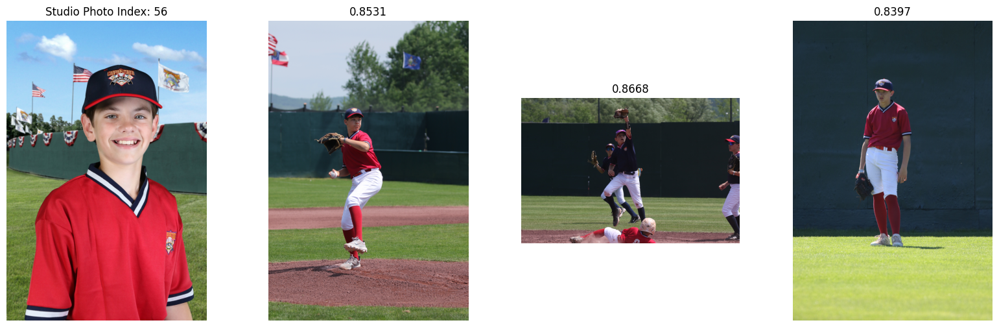

Matching game photos for studio photo index 57:
[(54, 0.86026764), (357, 0.7977245), (576, 0.84500927), (710, 0.8532689), (992, 0.86942047), (997, 0.83170605), (1065, 0.7813611)]
7


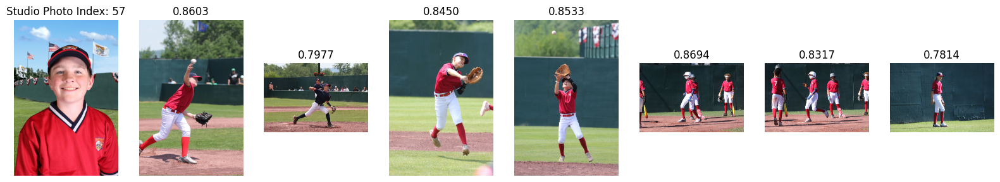

Matching game photos for studio photo index 58:
[(108, 0.7896586), (110, 0.84252775), (127, 0.806029), (128, 0.8460625), (139, 0.7938356), (151, 0.82135105), (152, 0.71908677), (162, 0.8681976), (1125, 0.842506)]
9


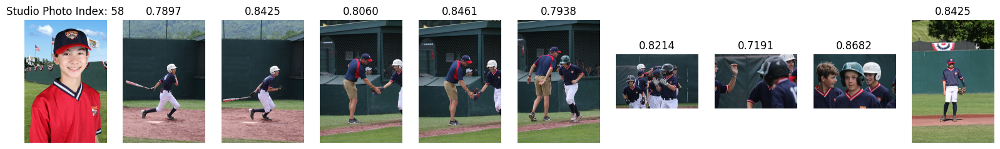

Matching game photos for studio photo index 59:
[(63, 0.7439145), (64, 0.8633969), (74, 0.78876346), (111, 0.8349266), (112, 0.7573087), (113, 0.8641108), (141, 0.8656522), (153, 0.76074547), (156, 0.7745667), (160, 0.7650803), (647, 0.8262325), (834, 0.8503191), (1055, 0.85930943), (1166, 0.7691991), (1172, 0.8347757), (1178, 0.79529953), (1184, 0.8199453)]
17


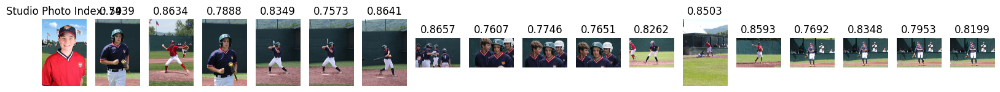

Matching game photos for studio photo index 60:
[]
0
No matches found.
Matching game photos for studio photo index 61:
[(10, 0.813596), (64, 0.8325016), (65, 0.77980316), (324, 0.8058116), (325, 0.761761), (326, 0.7902537), (340, 0.82977563), (341, 0.84327185), (349, 0.8487228), (350, 0.72222817), (357, 0.8341358), (422, 0.8008358), (426, 0.8510797), (445, 0.8550133), (466, 0.8608806), (467, 0.83279216), (520, 0.8699562), (522, 0.795841), (630, 0.85508466)]
19


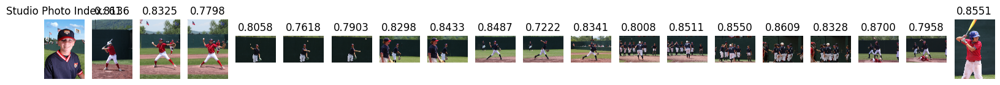

Matching game photos for studio photo index 62:
[(225, 0.7324712), (241, 0.7555291), (1031, 0.75558615)]
3


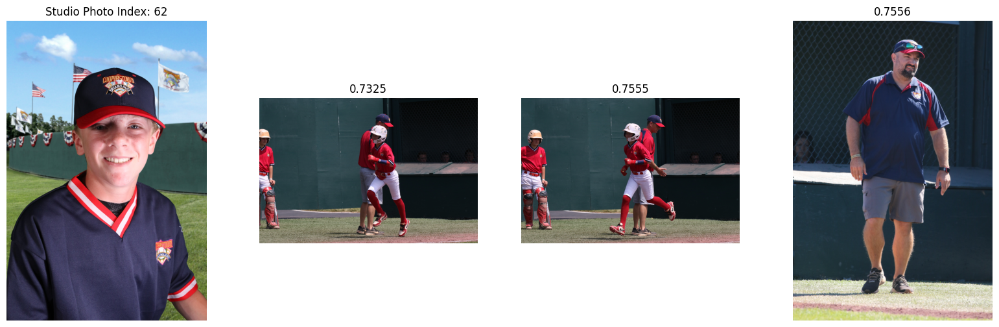

Matching game photos for studio photo index 63:
[(366, 0.84208447), (426, 0.86428547), (821, 0.84033823)]
3


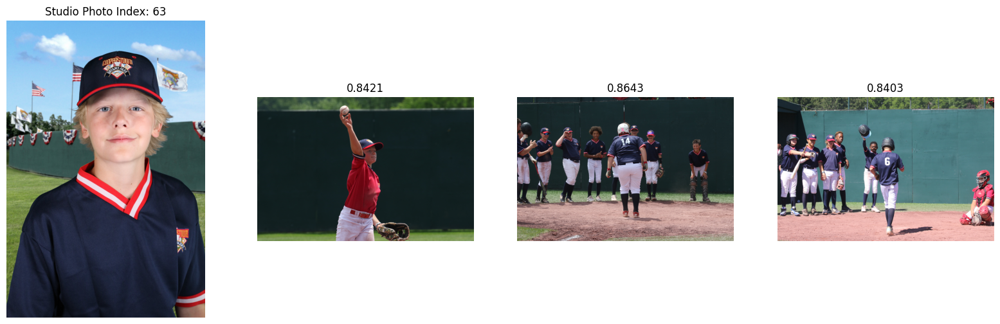

Matching game photos for studio photo index 64:
[(170, 0.7670408), (173, 0.85859925), (306, 0.8460321)]
3


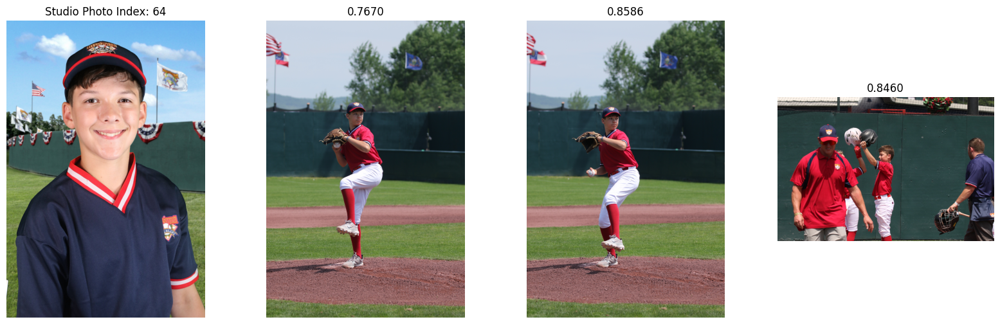

Matching game photos for studio photo index 65:
[(201, 0.81590545), (203, 0.8522968), (567, 0.80058736), (1054, 0.83461905)]
4


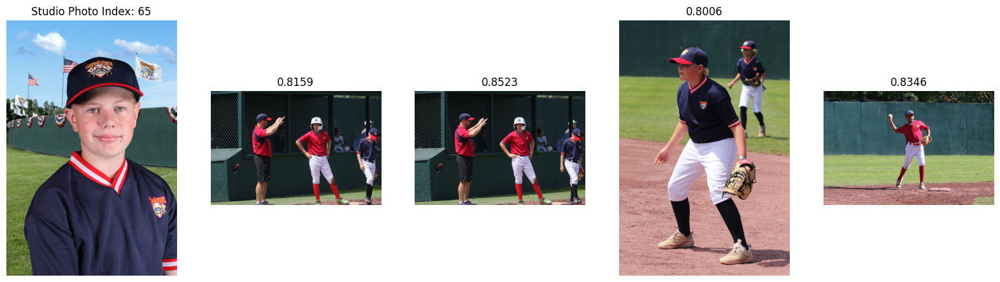

Matching game photos for studio photo index 66:
[(59, 0.748648), (60, 0.72146153), (61, 0.81444633), (64, 0.77568537), (65, 0.73877907), (66, 0.74418414), (69, 0.7907355), (70, 0.80437946), (71, 0.8039434), (72, 0.74405843), (115, 0.77211547), (116, 0.8352813), (118, 0.72949684), (119, 0.8403549), (120, 0.83652186), (121, 0.8269356), (122, 0.83074945), (123, 0.852553), (213, 0.827404), (214, 0.82074416), (253, 0.8629301), (269, 0.86531496), (533, 0.86961854), (548, 0.8688607), (578, 0.8295761), (1000, 0.8462452), (1011, 0.8189363)]
27


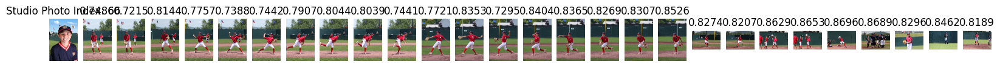

Matching game photos for studio photo index 67:
[(99, 0.8599396), (350, 0.83211637), (357, 0.847647), (405, 0.8444111), (406, 0.86614215), (413, 0.85633385), (432, 0.84929967), (445, 0.8624911), (455, 0.86723185), (929, 0.8597785)]
10


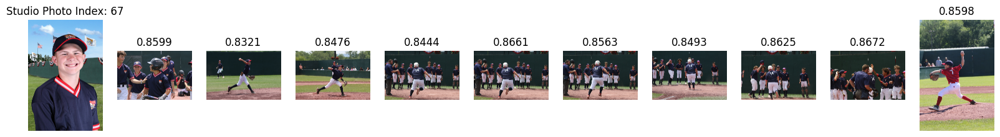

Matching game photos for studio photo index 68:
[(8, 0.7977017), (12, 0.8597078), (16, 0.8566855), (17, 0.822029), (18, 0.8462898), (68, 0.86287546), (69, 0.80403924), (70, 0.78087896), (71, 0.77354485), (72, 0.85227704), (201, 0.8634237), (433, 0.7731708), (759, 0.8689775), (760, 0.81773853), (838, 0.85035986), (853, 0.8692001), (856, 0.7816272), (857, 0.8507178), (1020, 0.8360447)]
19


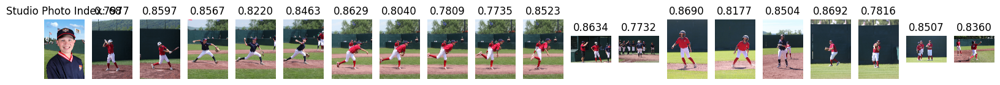

Matching game photos for studio photo index 69:
[(328, 0.8699963), (422, 0.84818447), (426, 0.8479538), (441, 0.8423727), (445, 0.81707007)]
5


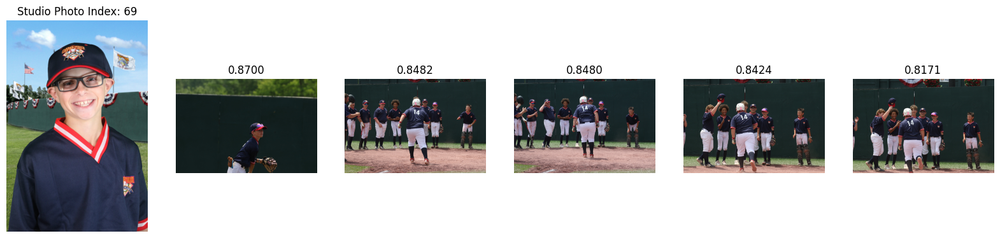

Matching game photos for studio photo index 70:
[(203, 0.86071455), (880, 0.8601962), (947, 0.86897194), (1020, 0.8360092)]
4


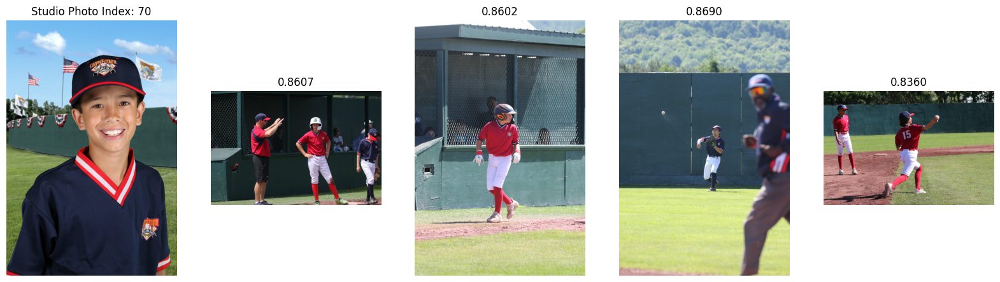

Matching game photos for studio photo index 71:
[(43, 0.8673817), (49, 0.7895692), (50, 0.74039596), (51, 0.731475), (52, 0.80202496), (53, 0.8355923), (54, 0.68177885), (55, 0.82811403), (56, 0.80563915), (254, 0.83522856), (271, 0.866074), (357, 0.8073077), (395, 0.8067455), (496, 0.71319956), (497, 0.79267395), (576, 0.8656746), (710, 0.86612636), (797, 0.8340531), (928, 0.8625388), (1040, 0.86590785)]
20


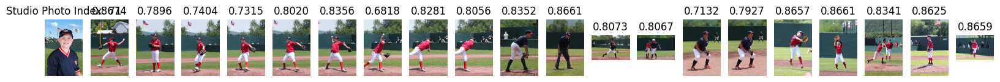

Matching game photos for studio photo index 72:
[(180, 0.8651309)]
1


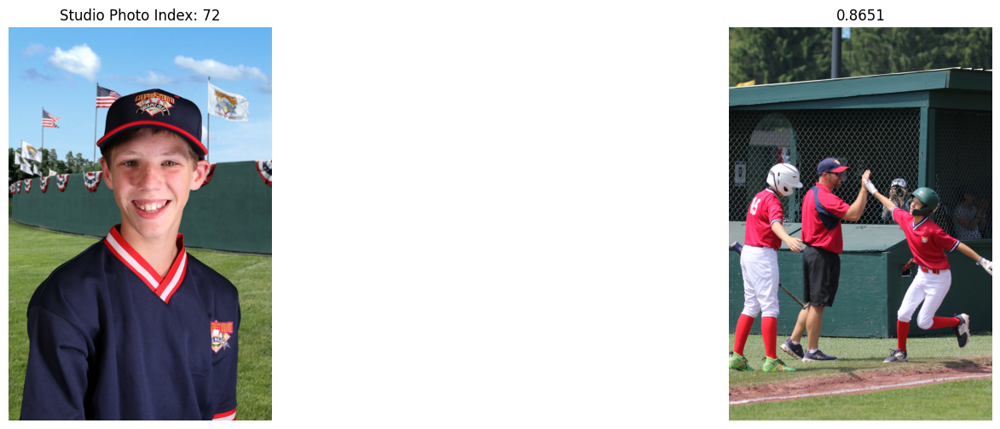

Matching game photos for studio photo index 73:
[(412, 0.83273035), (420, 0.79159206), (567, 0.809907), (827, 0.8602476), (835, 0.83578795), (1069, 0.8332397)]
6


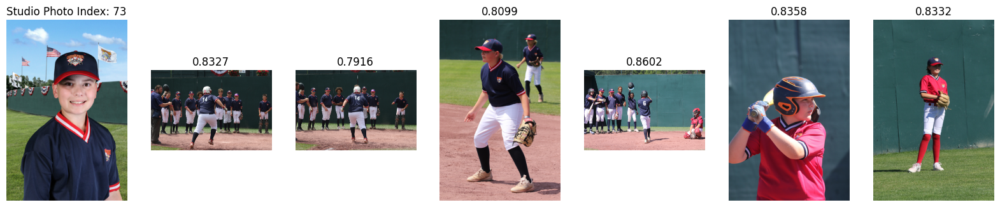

Matching game photos for studio photo index 74:
[(43, 0.8463288), (54, 0.7828498), (340, 0.7797356), (341, 0.76746553), (357, 0.74810964), (377, 0.85877275), (441, 0.7977152), (445, 0.8038155), (671, 0.8242697), (673, 0.81097496), (675, 0.85654914), (767, 0.86930364), (992, 0.8675742), (995, 0.81791717), (997, 0.81475466), (1034, 0.8671924), (1065, 0.8451045)]
17


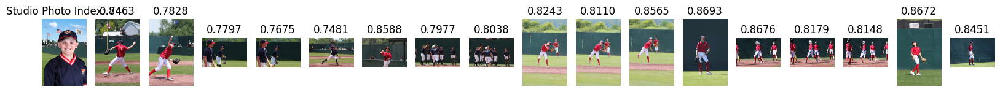

Matching game photos for studio photo index 75:
[]
0
No matches found.
Matching game photos for studio photo index 76:
[(973, 0.8673351)]
1


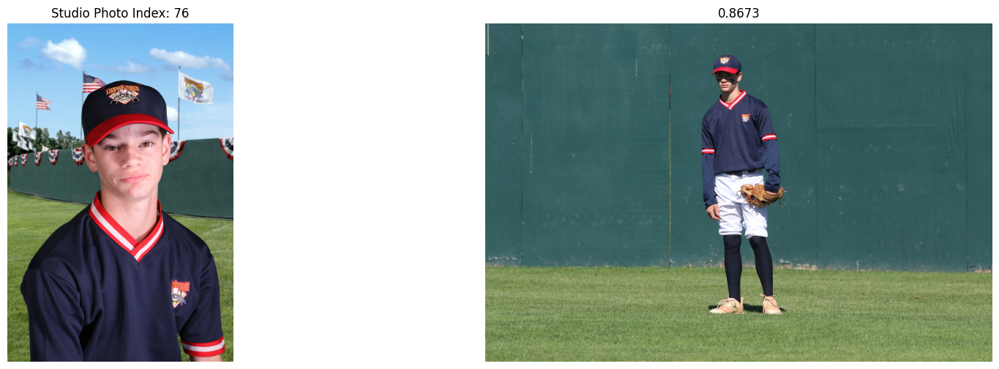

Matching game photos for studio photo index 77:
[(113, 0.85990417), (224, 0.8220184), (367, 0.8380937), (404, 0.85164535), (427, 0.8393506), (431, 0.8358761), (437, 0.81188107), (440, 0.8486727), (465, 0.8556643), (1054, 0.7872739), (1055, 0.8148949)]
11


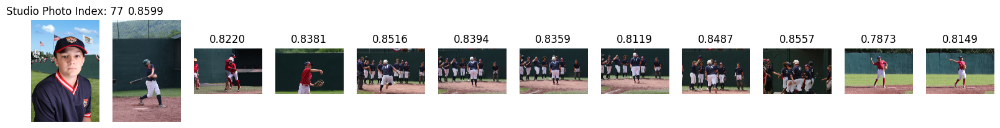

Matching game photos for studio photo index 78:
[]
0
No matches found.
Matching game photos for studio photo index 79:
[(582, 0.86554235)]
1


KeyboardInterrupt: 

In [143]:
# Display results, but load and display the original images (using the file paths)
for studio_idx, matches in results.items():
    print(f'Matching game photos for studio photo index {studio_idx}:')
    print(matches)  # List of matched game photos (indices and distances)
    print(len(matches))
    if matches:
        # Load and display the studio image using the file path
        studio_image = Image.open(studio_photos_paths[studio_idx])
        # Set up the plot for studio and matched game images
        plt.figure(figsize=(20, 6))
        plt.subplot(1, len(matches) + 1, 1)
        plt.imshow(studio_image)
        plt.title(f'Studio Photo Index: {studio_idx}')
        plt.axis('off')
        # Display each matched game image using the original file path
        for i, (game_idx, distance) in enumerate(matches):
            game_image = Image.open(game_photos_paths[game_idx])  # Load the match image by path
            plt.subplot(1, len(matches) + 1, i + 2)
            plt.imshow(game_image)
            plt.title(f'{distance:.4f}')
            plt.axis('off')
        # Show the plot with studio and match images
        plt.show()
    else:
        print("No matches found.")